# PW 1 - Practical work on SAR imaging : introduction to SAR data and interferometric processing 
The aim of this PW is to get familiar with SAR data (high dynamic of the images, complex data with ampltidue and phase). After a first part on the visualization of such data and the understanding of the image content, the second part is dedicated to the processing of phase and interferometric data.

## 1. Analysis of a series of SAR images
In this part, we will have a look at a temporal series of 25 SAR images acquired [from 2015-10-06 to 2016-11-05](https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/PileLely_3072x1024RECALZ4.label), with a time delay of approximately 12 days.

By making use of these SAR images, we will see the main differences with respect to conventional natural images and develop some simple tools to visualize an image, interpret it and detect temporal changes.

In [5]:
#!wget https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py

import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath
from google_drive_downloader import GoogleDriveDownloader as gdd


plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.max_open_warning'] = 30

In [6]:
# Download of the time series
webpage = 'https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/'
imagename = 'lely_tuple_multitemp.IMA'
imaslc = mvalab.imz2mat(webpage+imagename) # complex image

time_series_amp = np.abs(imaslc[0]) # taking an array of shape [n_rows,n_columns,n_dates] in amplitude format

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.dim
Multitemporal image 25 data
Fichiers PC
Image  complex float
lecture .dim OK -> largeur:512 hauteur:512 profondeur:25
Debug 2 4 512
4 512 <f


### Question 1.1: display a SAR image
SAR images have a long-tailed distribution, making its dynamic range to be wide. Plot the image with matplotlib. What do you see? 

It looks like an optical image with a low exposition and a low contrast. How can you improve the contrast of a SAR image, in order to have a more pleasant visualization?
Implement a function to plot a SAR image and comment the results obtained. 

A usual way to do this, is the saturate all the values above a certain threshold (often chosen as the mean + 3 times the standard deviation of the image) and do a linear stretching for the other values. 
Explain the effect of this processing and what you see in the resulting image. 

### Answer 1.1
First, we see a black image. We can improve the contrast of a SAR image by saturating all the values above a certain threshold. The effect of this processing is to increase the contrast of the image. We see now the image but it is not very clear, we can't see the details.

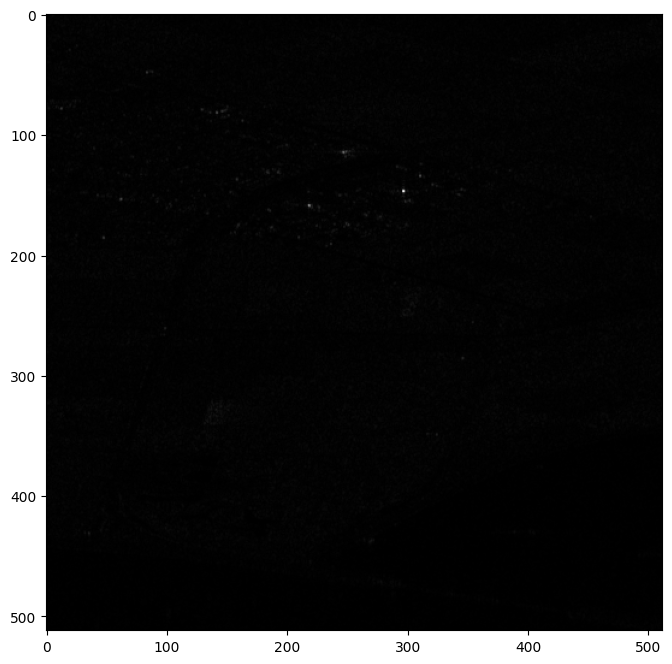

In [7]:
plt.figure()
plt.imshow(time_series_amp[:,:,0],cmap='gray')
plt.show()

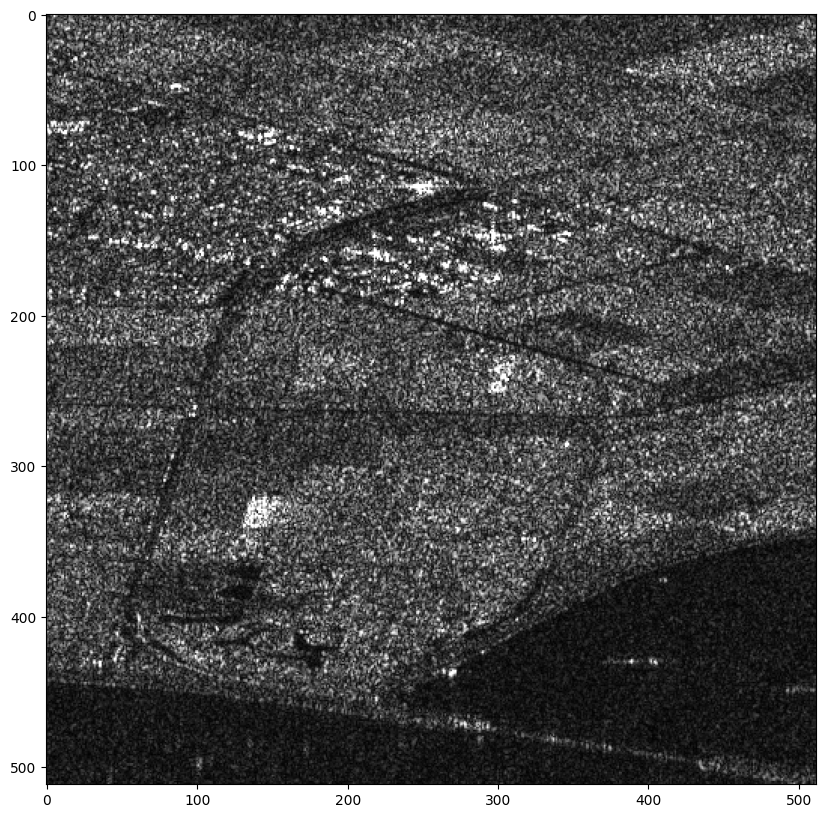

In [8]:
# implement the following function to plot a SAR image
# you can use a threshold as mean + 3 sigma
# and the np.clip function

def plot_sar(ima):
  plt.figure(figsize=(10,10))
  t = ima.mean() + 3*ima.std() # threshold
  plt.imshow(np.clip(ima,0,t),cmap='gray') # display the saturated image
  plt.show()

plot_sar(time_series_amp[:,:,0])

### Question 1.2: Image orientation
Is the image in the correct geographic orientation? 
Apply the proper flipping if necessary.

To see the corresponding optical image and find the correct flipping, you can have a look on Google Maps at [this location](https://goo.gl/maps/LQcd3Uz9U7qCoRrH6).

### Answer 1.2
No, the image is not in the correct geographic orientation. We have to apply the flipping on axis 1.

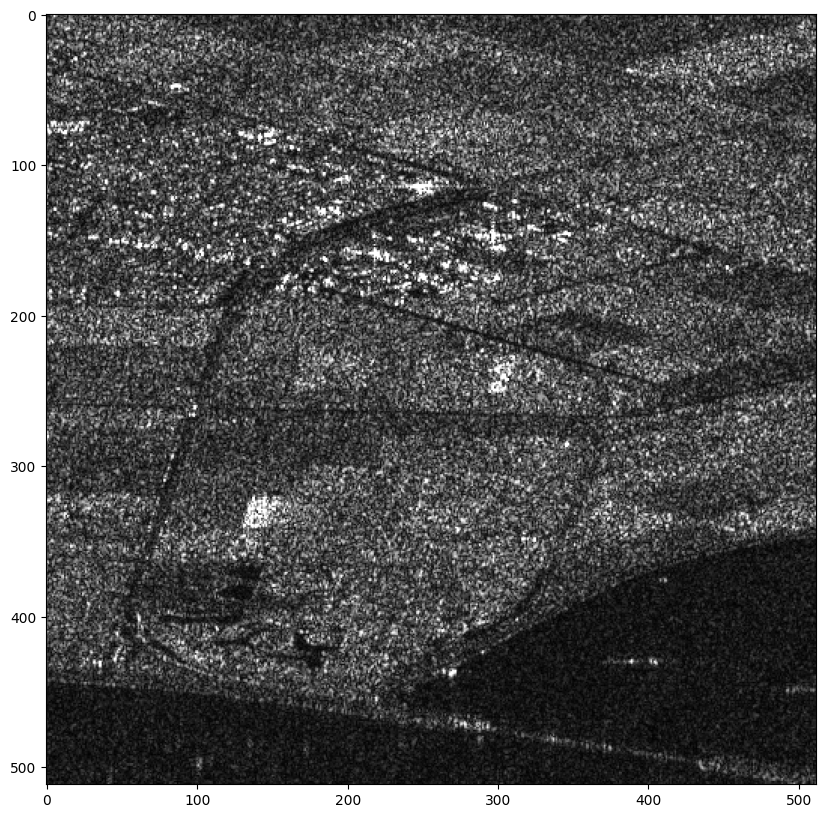

In [9]:
plot_sar(time_series_amp[:,:,0])

In [10]:
time_series_flipped = np.copy(time_series_amp)
time_series_flipped = np.flip(time_series_flipped, axis=1)  # apply flipping if necessary using np.flip

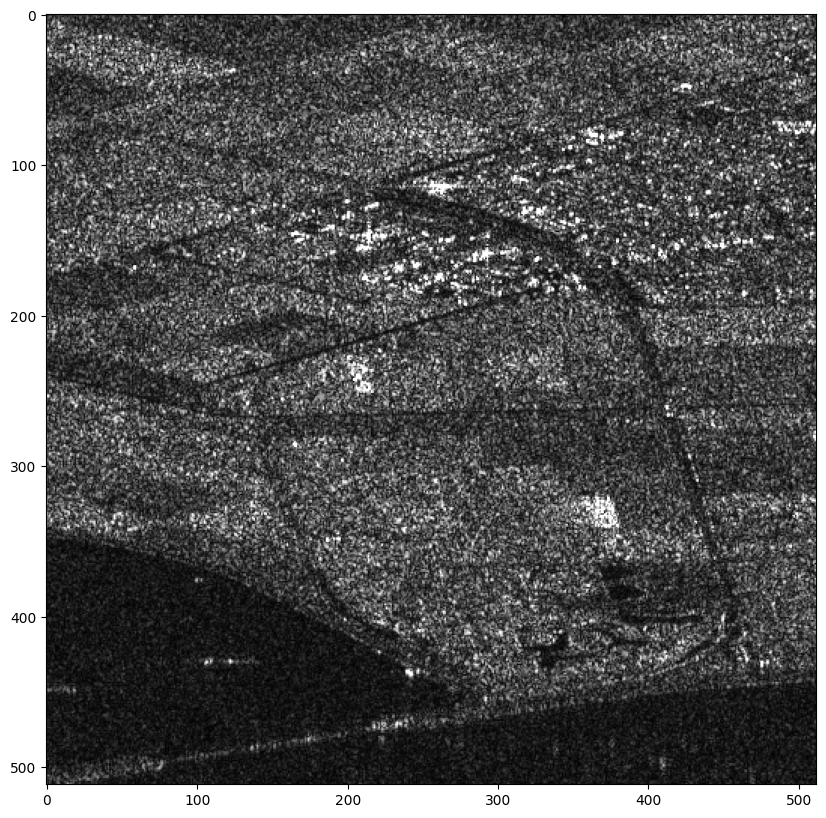

In [11]:
plot_sar(time_series_flipped[:,:,0])

### Question 1.3: Interpretation of a SAR image
The image contains 
- an urban area, 
- agricultural fields, 
- water, 
- moving objects (ships), 
- a bridge 

Explain the appearence of these objects in the SAR image.

### Answer 1.3
- urban area: Pixels of the urban area are very bright because of the high backscattering of the buildings.
- agricultural fields: Pixels of agricultural fields are dark because of the low backscattering of the fields, but less than the water.
- water: Pixels of water are dark because of the low backscattering of the water.
- moving objects (ships): Pixels of ships are bright because of the high backscattering of the ships.
- the bridge: Bridge is bright because of the high backscattering of the bridge.

### Question 1.4: Multitemporal analysis and change detection
To detect changes occurring between three dates, images can be displayed in a false colour representation, each date being one channel of a RGB image. Implement the function ```plot_changes```.

Then, choose three dates from the multitemporal stack (indexes from 0 to 24). From the false colour representation, can you tell when a particular change has occurred? Explain how you can interpret it.

### Answer 1.4

For the differents zones that we have seen in the previous question, we can notice that there have been some particular changes between the images.  
The reflexity of those zones has changed between the two images.

Thanks to the false colour representation, we can see where the changes have occured. There are changes in fields, because images were taken at different moments, so the change is due to farming practices. Urban area, water or bridge have not changed because they are not affected by seasons.

In [12]:
def plot_changes(im1,im2,im3):
    im_mean = (im1 + im2 + im3)/3
    threshold = np.mean(im_mean) + 3*np.std(im_mean) # threshold
    # apply thresholding and shrinking of each image between [0;1] for RGB data
    im1 = np.clip(im1,0,threshold)
    im1 = im1/threshold
    im2 = np.clip(im2,0,threshold)
    im2 = im2/threshold
    im3 = np.clip(im3,0,threshold)
    im3 = im3/threshold
    # create a false RGB image by stacking the three dates
    image = np.dstack((im1,im2,im3))
    plt.figure(figsize=(12,12))
    plt.imshow(image)
    plt.show()

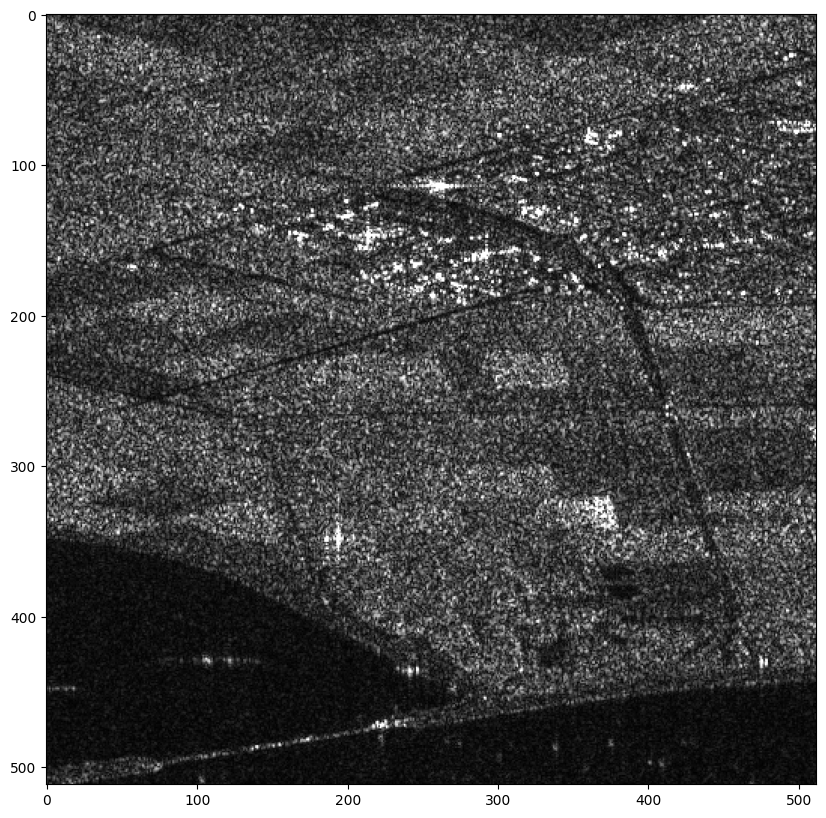

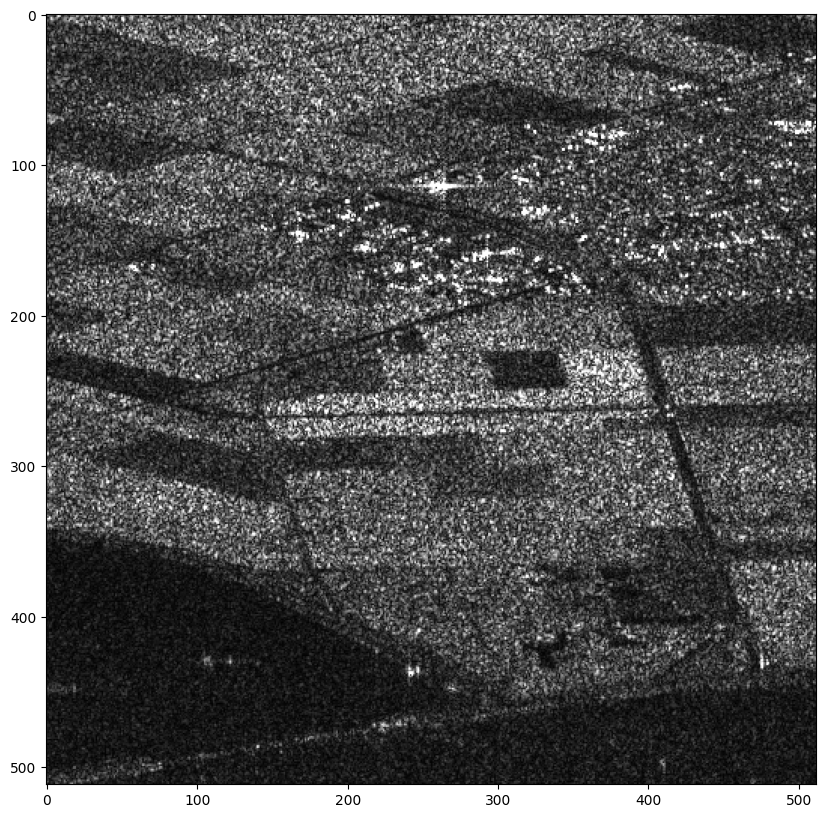

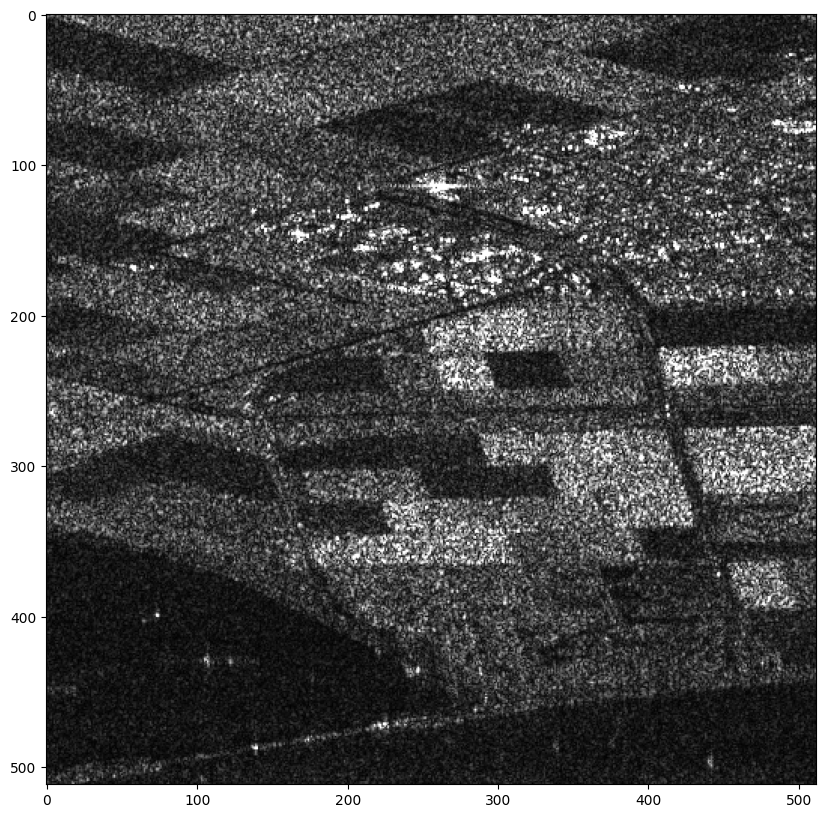

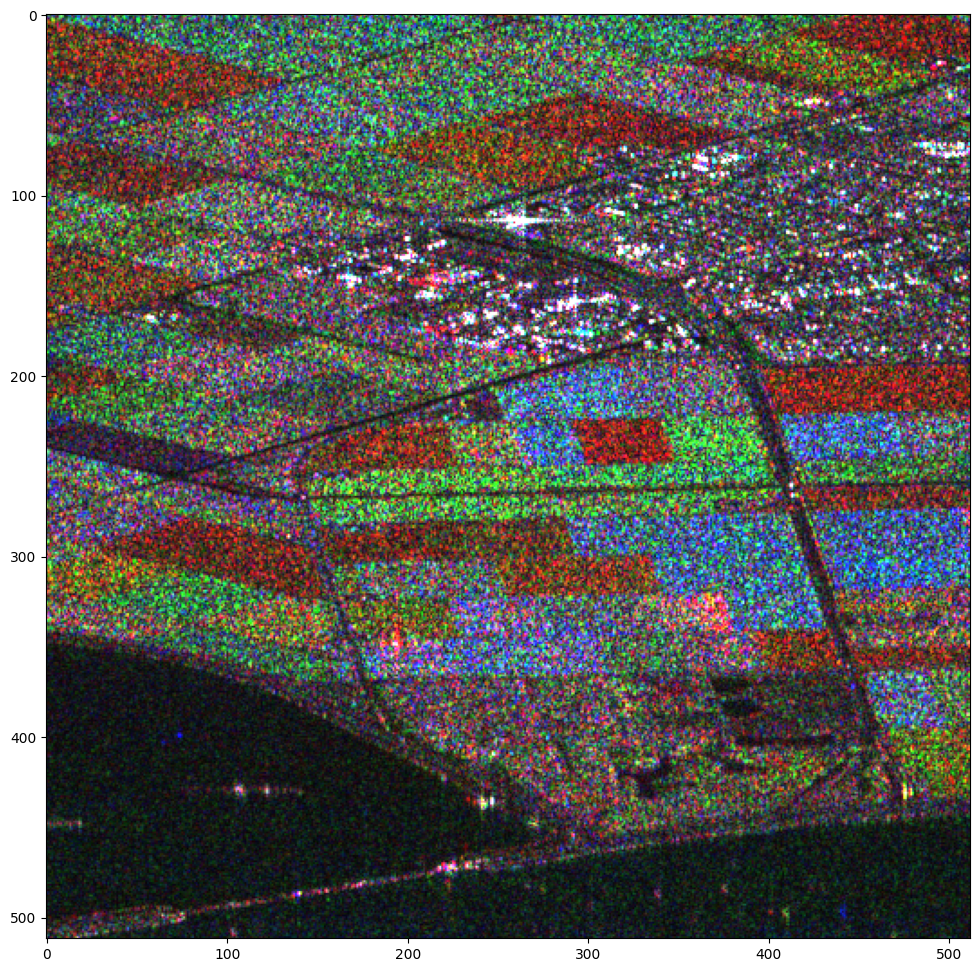

In [13]:
# choose three dates
idx1 = 1 
idx2 = 10 
idx3 = 15
im1 = time_series_flipped[:,:,idx1]
im2 = time_series_flipped[:,:,idx2]
im3 = time_series_flipped[:,:,idx3]

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

### Question 1.5: Create an image with isotropic pixels
The image pixels have the following size: $13.86[m]\times 2.3[m]$ in range $\times$ azimuth (approximately, pixel height is 5 times greater than pixel length). How can you create an image with approximately squared pixels?

### Answer 1.5

First, we apply a low pas filter to reduce the aliasing effect. Then, we apply a resampling to create an image with approximately squared pixels.

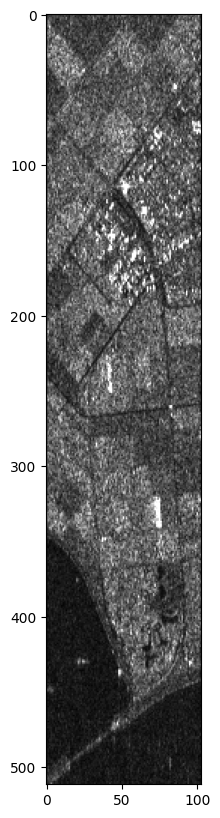

In [24]:
ima_tmp = time_series_flipped[:,:,0]

mask = np.ones((1,5)) # define a mask
ima_filtered = signal.convolve2d(ima_tmp,mask,mode='same') # filter the image with the appropriate mask
ima_squared_pixels = ima_filtered[:,::5] # resample the filtered image
plot_sar(ima_squared_pixels)

## 2. Analysis of TerraSAR-X images acquired over the Paris area
In this part we will use an image of TerraSAR-X sensor (metric resolution) of Paris. 
This is a temporal stack, you can choose the date you want. 
(The questions are similar to the previous ones and will not be done during the PW but later as personal work).

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.dim
Multitemporal image 21 data
Fichiers PC
Image  complex short
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:21
Debug 2 2 2048
2 2048 <h
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


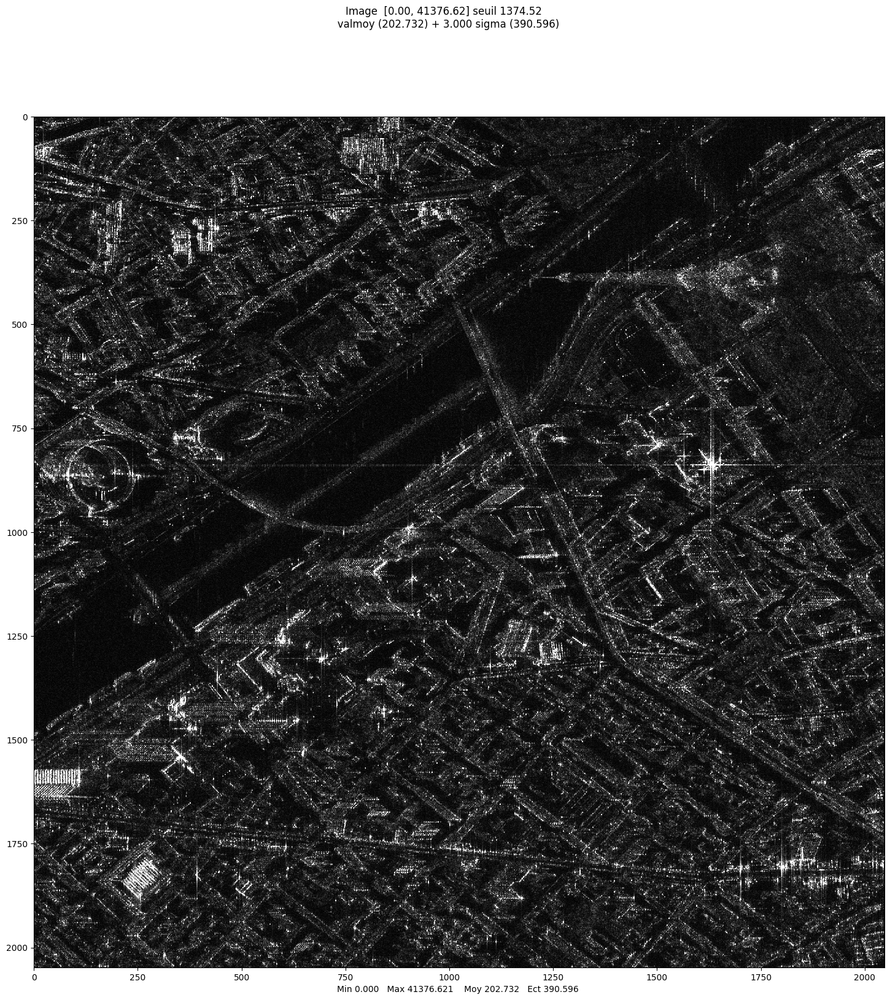

array([[ 58.30951895,  59.07622195, 145.77379737, ...,  22.84731932,
         42.05948169,   5.83095189],
       [ 90.00555538,  64.77653896, 117.08543889, ...,  41.76122604,
         17.80449381,   2.        ],
       [259.49373788, 153.83432647,  92.00543462, ..., 129.18978288,
         80.80222769,  43.18564576],
       ...,
       [132.37069162, 283.06359709, 409.33238328, ...,  88.05112151,
         62.03224968,  11.04536102],
       [ 36.76955262, 239.15058018, 382.41469637, ...,  11.        ,
         44.72135955,  10.        ],
       [100.56838469, 189.78145326, 234.04700383, ...,  17.49285568,
         94.42986816,   8.60232527]])

In [25]:
# 21 images from TerraSAR-X between 2009-01-24 and 2010-11-26
webpage='https://perso.telecom-paristech.fr/tupin/TPSAR/paris/'
image='PileiEiffeljavelRECALZ4RECSP.IMA'
im_slc_tsx_paris_liste=mvalab.imz2mat(webpage+image);
im_slc_tsx_paris = im_slc_tsx_paris_liste[0][:,:,0]
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visusar(np.abs(im_slc_tsx_paris))

### Question 2.1: interpretation
Check that you recognize the main buildings on this image. 
What is the position of the track of the sensor relatively to this image ?

Explain the appearence of the following buildings in the amplitude image : Eiffel Tower, Maison de la radio, Pont de Bir-Hakeim (you can use a [satellite optic image on googlemaps](https://www.google.com/maps/place/Eiffel+Tower/@48.851143,2.2797819,447m/data=!3m1!1e3!4m5!3m4!1s0x47e66e2964e34e2d:0x8ddca9ee380ef7e0!8m2!3d48.8583701!4d2.2944813) to help you).



### Answer 2.1

We can recognize the Eiffel Tower. The sensor is at the right because the eiffel tower is on the left of the image. It's the same for the Maison de la radio. The Pont de Bir-Hakeim is on the right of the image, so the sensor is on the left. 

The pont de Bir-Hakeim is in the middle of the Seine appears bright because of the high backscattering of the bridge, even if the water is dark because of the low backscattering of the water.

### Question 2.2: change detection
Identify and explain the appearence of some changing objects on Paris.

### Answer 2.2

The urban area doesn't change because it is not affected by seasons like the fields. Most of the change appears with the boats on the Seine.

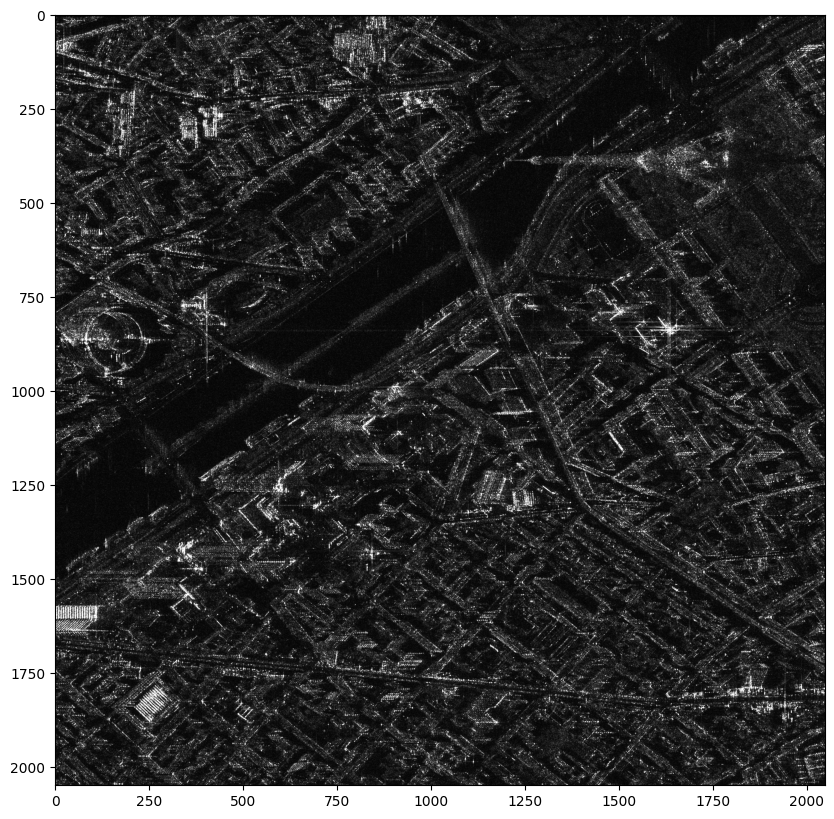

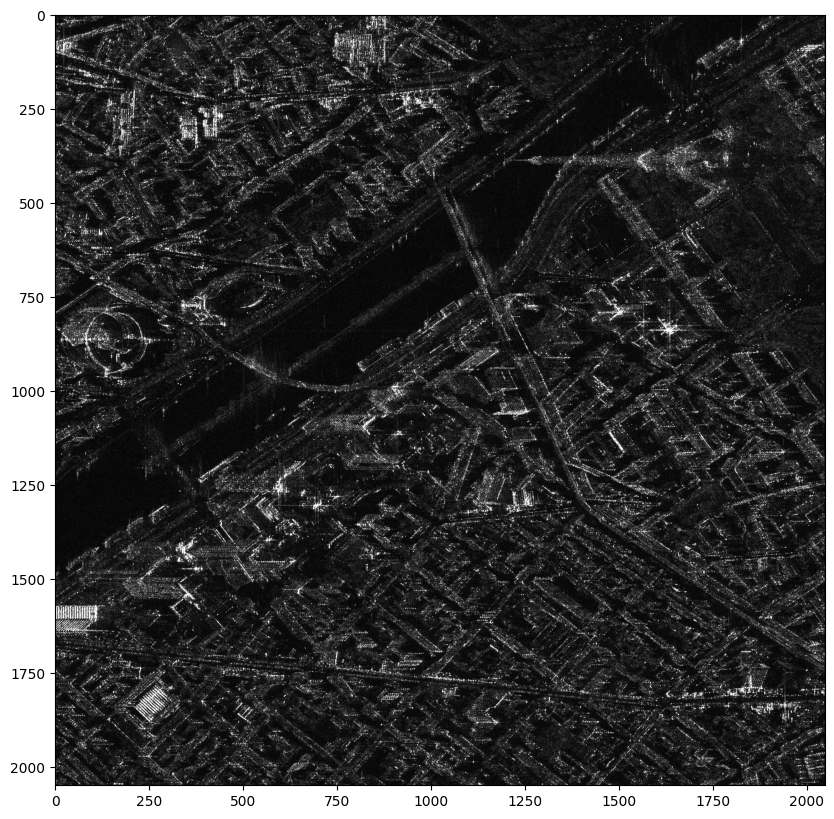

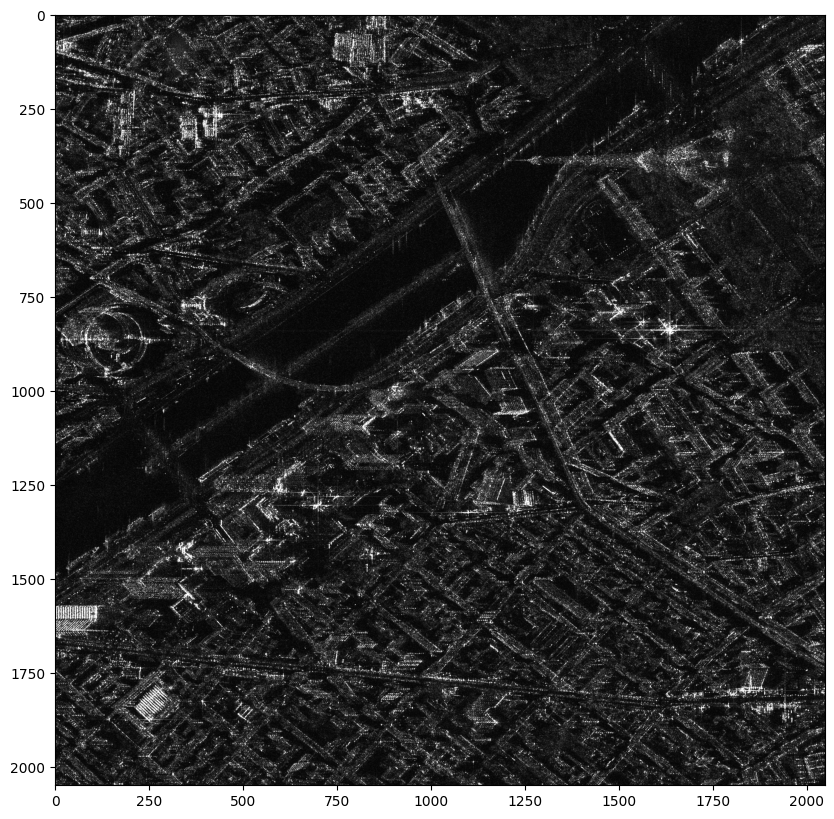

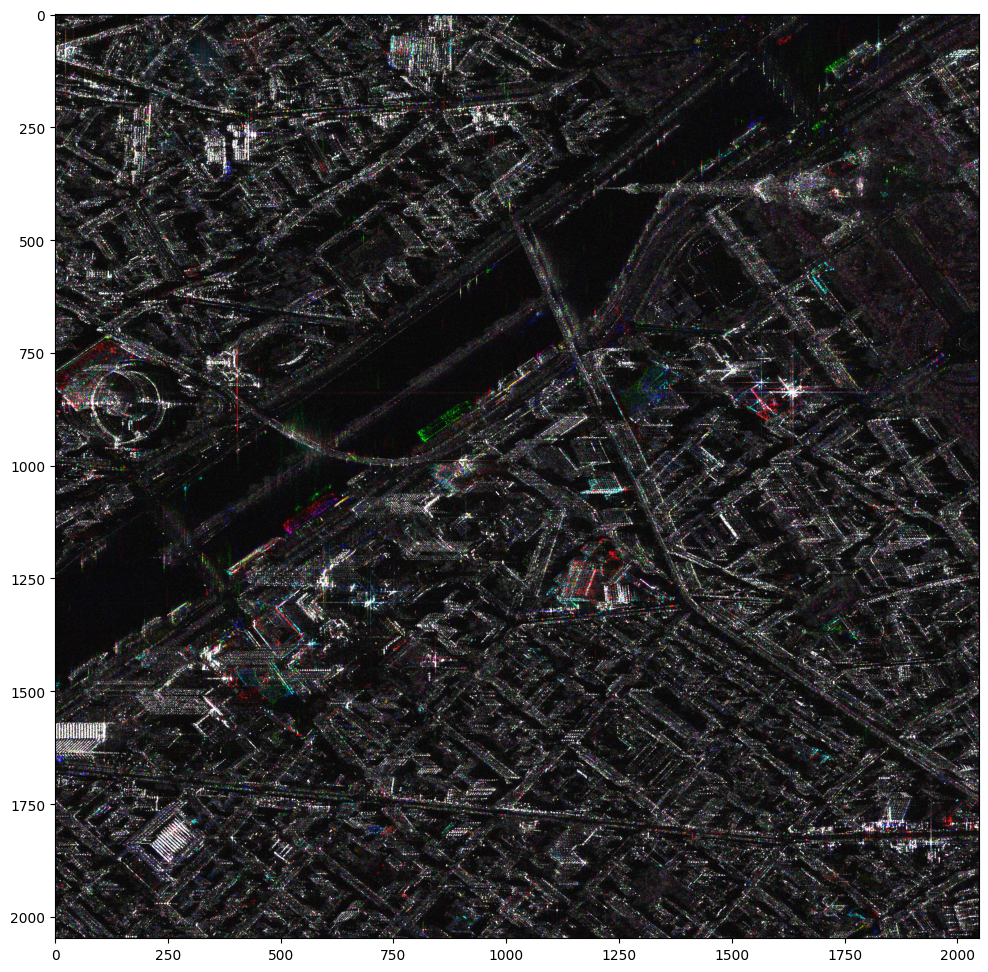

In [26]:
idx1 = 1 
idx2 = 10 
idx3 = 15
im1 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx1])
im2 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx2])
im3 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx3])

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

## 3. SAR interferometry
In this part, the objective is to see the content of the phase of a SAR image and to do a simple processing chain to obtain an interferogram with topographic fringes. 
You will be able to have a look to the optical image [on this link](https://g.page/ParcoEtna?share)

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


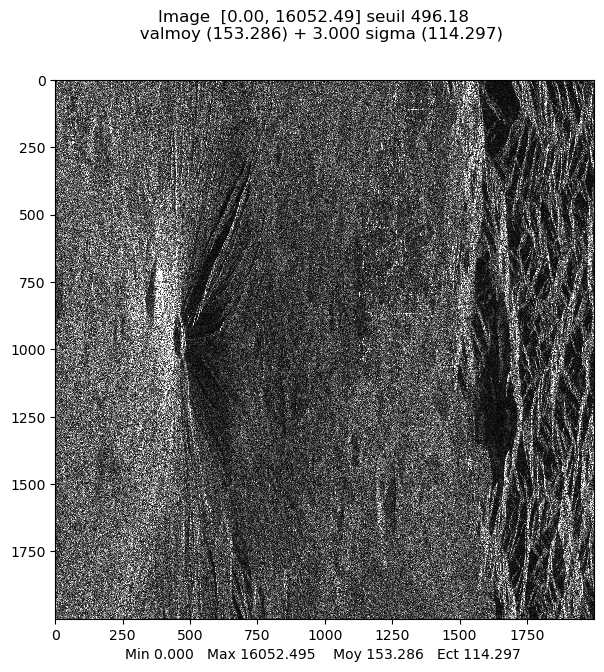

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


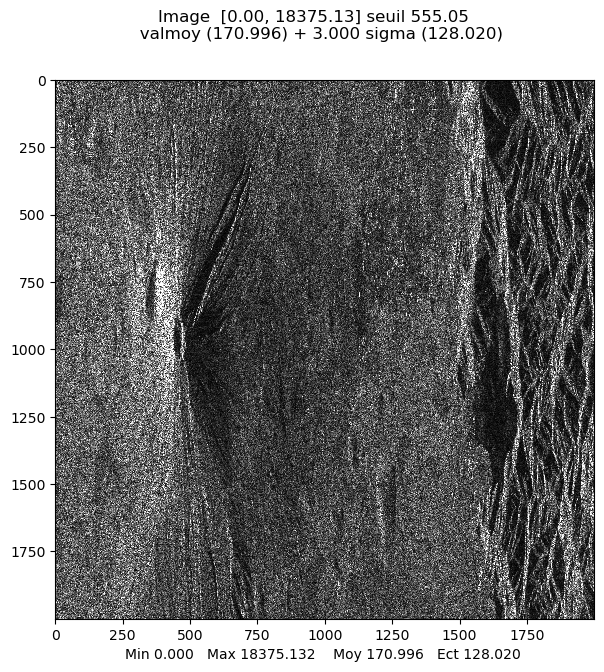

array([[246.54614173, 283.98943642,  94.86832981, ..., 499.65287951,
         82.00609733, 555.05417664],
       [257.41989045, 199.25109786, 141.73566947, ..., 399.60605601,
         55.        , 385.81083448],
       [146.10954794,  62.03224968,  77.79460136, ...,  67.08203932,
        205.24375752, 155.95512175],
       ...,
       [254.2380774 , 237.76669237, 199.58206332, ...,  72.9451849 ,
         43.68065934,  74.43117626],
       [182.00274723, 226.37358503, 142.5622671 , ...,  91.58602513,
         45.48626166,  31.        ],
       [ 57.97413216, 237.76038358, 143.58969322, ...,  72.99315036,
         74.72616677,  77.1038261 ]])

In [30]:
#!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Master.mat
#!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Slave.mat
imageM='./Master.mat'
imageS='./Slave.mat'
imamaitre=mvalab.matlab2imz(imageM,'Master')
imaslave=mvalab.matlab2imz(imageS,'Slave')

imamaitre = imamaitre[0][1000:3000,:]
imaslave = imaslave[0][1000:3000,:]
ncolonnes=imamaitre.shape[1]
nlignes=imamaitre.shape[0]

#%%
plt.rcParams['figure.figsize'] = [7,7]
mvalab.visusar(imamaitre)
mvalab.visusar(imaslave)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


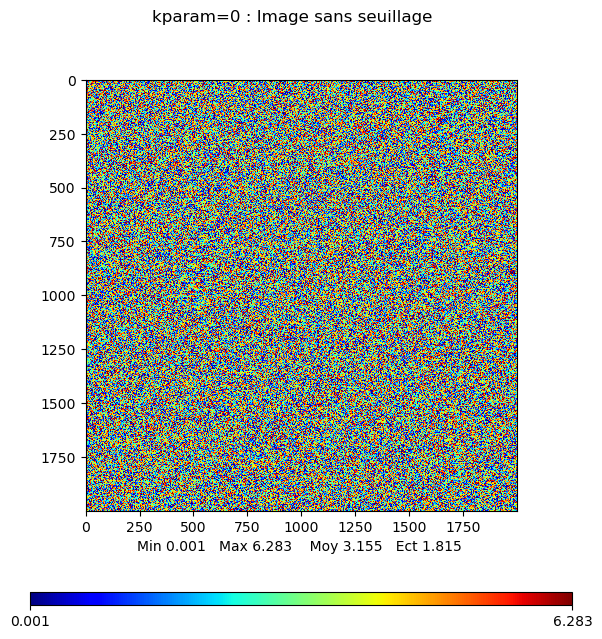

array([[6.12759048, 4.74305421, 4.41221781, ..., 1.9513027 , 5.200422  ,
        6.0785435 ],
       [0.78539816, 0.03569911, 0.609806  , ..., 2.89193238, 2.15744024,
        1.01336524],
       [1.61077501, 2.02577363, 2.68329259, ..., 5.24820022, 4.04275003,
        3.41047529],
       ...,
       [1.85360554, 1.2715139 , 1.81236203, ..., 3.18807078, 5.0244311 ,
        5.62461942],
       [4.13432394, 2.56347441, 0.83571537, ..., 0.14888995, 0.54937448,
        1.62479783],
       [0.04521802, 3.98984498, 3.34584682, ..., 2.89161403, 0.70862627,
        5.60998996]])

In [31]:
# display the phase of one image
#mvalab.visuinterfero uses an adapted lut to see the phase of an image
mvalab.visuinterfero(np.angle(imamaitre)+math.pi,0)


### Question 3.1
Do you recognize the area in the amplitude images ? Give a short interpretation. Visualize the phase of an image. Do you see any useful information?

### Answer 3.1
Yes we can recognize the area in the amplitude images. We can see the Etna volcano. We can't see any useful information in the phase image, it's not easily interpretable.

### Question 3.2
Compute the interferogram by computing $z_1.z_2^*$ and display the phase. Do you see any structured pattern ?

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


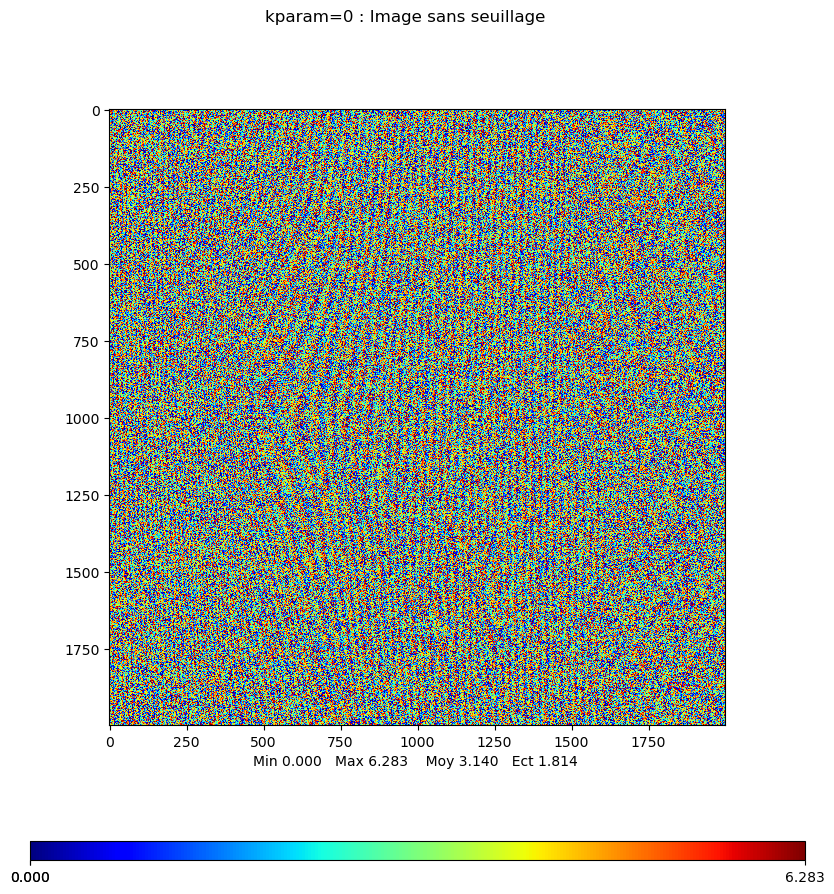

array([[2.55500648, 1.78918891, 1.87616982, ..., 3.10590681, 0.4758385 ,
        3.39207593],
       [0.89047844, 1.22598906, 3.15165491, ..., 1.95913171, 1.51393913,
        2.64900559],
       [5.98842716, 1.99352675, 3.45051094, ..., 4.1410515 , 4.09149189,
        4.72851706],
       ...,
       [0.90900284, 0.57246763, 6.18240116, ..., 0.54691894, 1.60453879,
        4.58963434],
       [0.98723683, 0.62201552, 4.9523198 , ..., 2.27134126, 1.53826569,
        3.19559415],
       [1.87772785, 0.76825464, 6.18330824, ..., 2.72646535, 5.6919621 ,
        4.09109503]])

In [26]:
raw_interf = imamaitre*np.conj(imaslave) # compute z1.z2*
plt.rcParams['figure.figsize'] = [7,7]
mvalab.visuinterfero(np.angle(raw_interf)+math.pi,0) # diplay the phase 

### Answer 3.2
Yes we can see fringes in the phase of the interferogram, the patern of the topography of the area. 

### Question 3.3: Registration of the two images
To compute an interferogram, the following steps have to be applied :
- registration of the two images (only a translation is searched)
- suppression of the vertical fringe pattern 
- filtering to improve the phase information.

Using the knowledge acquired on previous courses, propose a method and apply it to do the registration between the two images. Complete the code below.

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


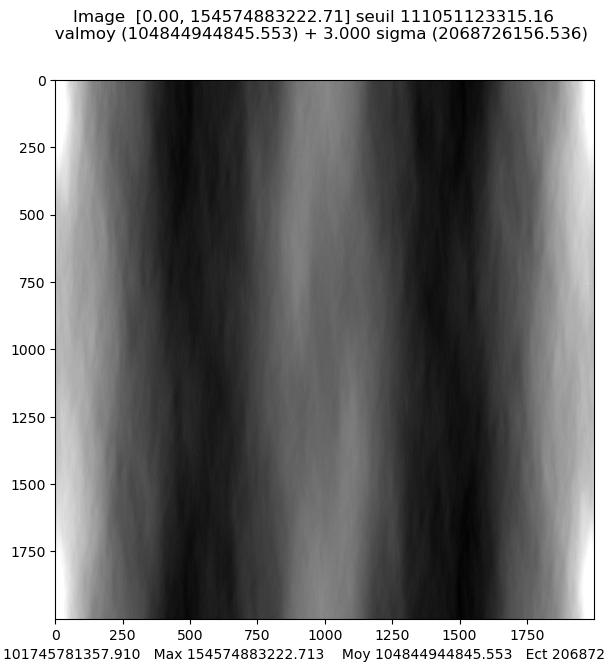

(1998, 0)
Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


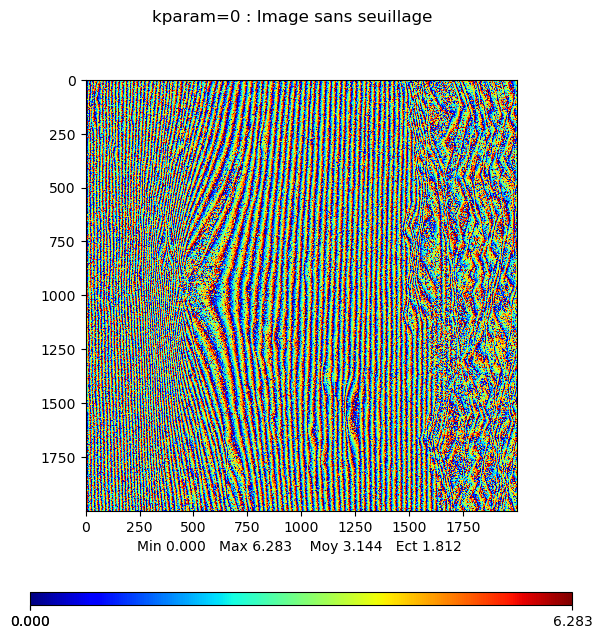

array([[4.22205732, 4.71080733, 5.17943616, ..., 0.84415399, 5.24916385,
        1.11339996],
       [4.88475065, 4.36758172, 4.71439299, ..., 5.99860473, 6.17553618,
        1.2324965 ],
       [4.49176528, 4.6466379 , 4.50604421, ..., 2.97654948, 0.68942589,
        1.65815508],
       ...,
       [3.68611537, 4.33310887, 4.64982345, ..., 3.02292211, 3.72458163,
        4.1057245 ],
       [0.56173994, 5.89279441, 4.58285269, ..., 1.30349405, 2.10797629,
        5.22151557],
       [0.1502983 , 5.18013493, 5.88769572, ..., 1.95881336, 0.06512516,
        0.96244501]])

In [37]:
# propose a method to extract the shift along the two axes
# to compute the correlation efficiently you can use the FFT 

# using the multiplication in the Fourier domain, compute the FFT of the correlation and then the correlation by inverse FFT
imacorfft = np.fft.fft2(np.abs(imamaitre))*np.fft.fft2(np.abs(imaslave)).conj() 
imacor = np.fft.ifft2(imacorfft)

#visualize the correlation image (maximum gives the translation value)
mvalab.visusar(imacor)
ishift = np.unravel_index(np.argmax(imacor), imacor.shape) # you can use np.argmax and np.unravel_index
print(ishift)

# compute the shift on the two axis
imaslaveroll=np.roll(imaslave, ishift[0], axis=0)
imaslaveroll=np.roll(imaslaveroll, ishift[1], axis=1)


# compute the interferogram and plot the interferometric phase
interfero= imamaitre*np.conj(imaslaveroll)
plt.rcParams['figure.figsize'] = [7, 7]
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)

### Question 3.4
What is the shift between the two images ? Which pattern do you see in the resulting fringes when computing the interferogram after the registration ? 

### Answer 3.4
We have a shift of 1998 pixels. We can see the fringes of the topography of the area, with less noise. The fringes are vertical.

### Question 3.5: Suppression of the orbital fringes 
To obtain the useful information about the topography the so-called orbital fringes have to be suppressed. It can be done by using the sensor parameters but in this practical work we propose to use a signal processing method. 
How can you detect a pure sinusoid in a signal ? (it is the case of the pattern we would like to suppress in the horizontal direction). Compute the frequency of this pattern and use it to suppress it in the registered secondary image. 

Which frequency did you obtain ? Is it the same for all the considered lines ? What do you see in the resulting interferogram after correction ? 

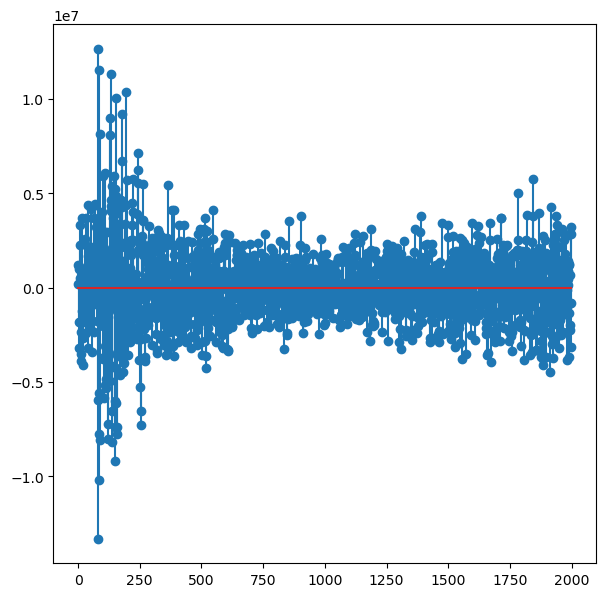

(84,)


In [41]:
# compute the main frequency of the pattern by choosing a line in the image and using the FFT
fftfringe = np.fft.fft(interfero[1700,:]) 
plt.figure()
plt.stem(fftfringe)
plt.show()

freq = np.unravel_index(np.argmax(np.abs(fftfringe)), fftfringe.shape)
print(freq)

### Answer 3.5a 
To detect a pure sinusoid in a signal, we can use the Fourier transform. We can see that the mean of the frequency of the pattern is 84. It is not the same for all the considered lines. 

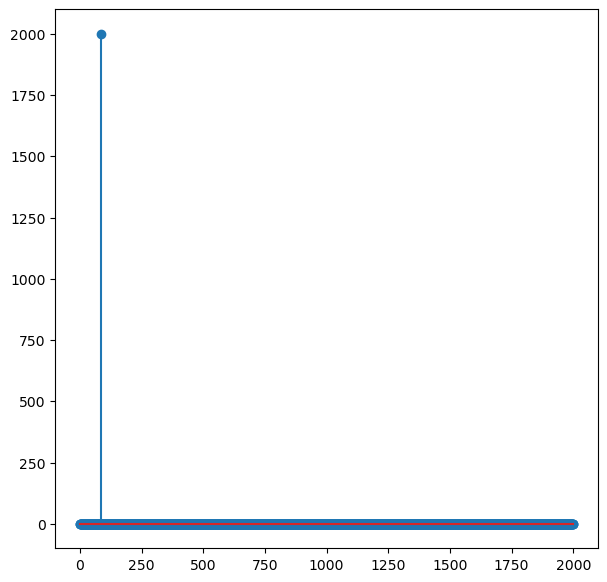

In [42]:
N = interfero.shape[1]
n = np.arange(0,N)
onde = np.exp(1j*2*math.pi*freq[0]*n/N) # create a pure wave using the previously computed frequency freq 
fonde = np.abs(np.fft.fft(onde))
plt.figure()
plt.stem(fonde)
plt.show()

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


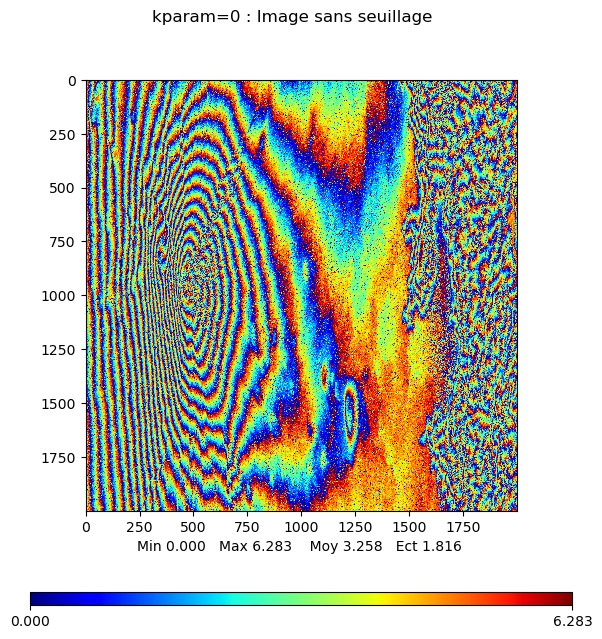

array([[4.22205732, 4.44691355, 4.65164859, ..., 1.63583533, 5.77695142,
        1.37729374],
       [4.88475065, 4.10368793, 4.18660542, ..., 0.50710078, 0.42013843,
        1.49639028],
       [4.49176528, 4.38274411, 3.97825664, ..., 3.76823083, 1.21721345,
        1.92204887],
       ...,
       [3.68611537, 4.06921509, 4.12203589, ..., 3.81460346, 4.25236919,
        4.36961828],
       [0.56173994, 5.62890063, 4.05506512, ..., 2.0951754 , 2.63576386,
        5.48540935],
       [0.1502983 , 4.91624114, 5.35990816, ..., 2.75049471, 0.59291273,
        1.22633879]])

In [43]:
# suppress the pattern by multiplying the interferogram by the conjugate of the pure wave
interferofine= np.multiply(interfero,onde.conj())

mvalab.visuinterfero(np.angle(interferofine)+math.pi,0)

### Answer 3.5b 
After correction, the resulting interferogram is clearer, we can see wider fringes. We have only the patern link to the topography of the area, without the noise due to the different frequencies (due to distance).

### Question 3.6: interferogram filtering
To improve the quality of the interferogram, some filtering can be applied to reduce the phase noise. Propose a suitable kernel by filling the code below.

How does the filtered interferogram look like?

### Answer 3.6
The filtered interferogram is clearer, we can see the fringes of the topography of the area. The noise is reduced. 

In [46]:
def interferogramme( tabvignette, tabvignette2, *therest) :
    """
    Computation of the complex interferogram between two images of the
    same size.
    By default, window size is set as 3x3 (dimx, dimy).
    It outputs a complex image, whose modulus is the coherence and whose phase 
    is the interferometric phase.
    """
    
    dimx=3
    dimy=3
    
    if(len(therest)==1):        
        dimx=therest[0]
        dimy=dimx
        
    if(len(therest)==2):       
        dimx=therest[0]
        dimy=therest[1]
    
    nlig=np.size(tabvignette,0)
    ncol=np.size(tabvignette,1)
    
    if nlig != np.size(tabvignette2,0)  :
        print(u'les deux images doivent avoir la même taille (%d  et %d)'%(nlig, np.size(tabvignette2,0)))
        return 0
    
    if ncol != np.size(tabvignette2,1)  :
        print(u'les deux images doivent avoir la même taille')
        return 0
    
    interf= np.multiply(tabvignette, np.conj(tabvignette2))

    # part to be completed to compute a multi-look interfergram by averaging on a local window
    
    
    mask = np.ones((dimx,dimy)) / (dimx*dimy)
    interfiltr = signal.convolve2d(interf,mask,mode='same')
    
    den1 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette)),mask,mode='same'))
    den2 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette2)),mask,mode='same'))
 
    return interfiltr/(den1*den2+1e-12)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


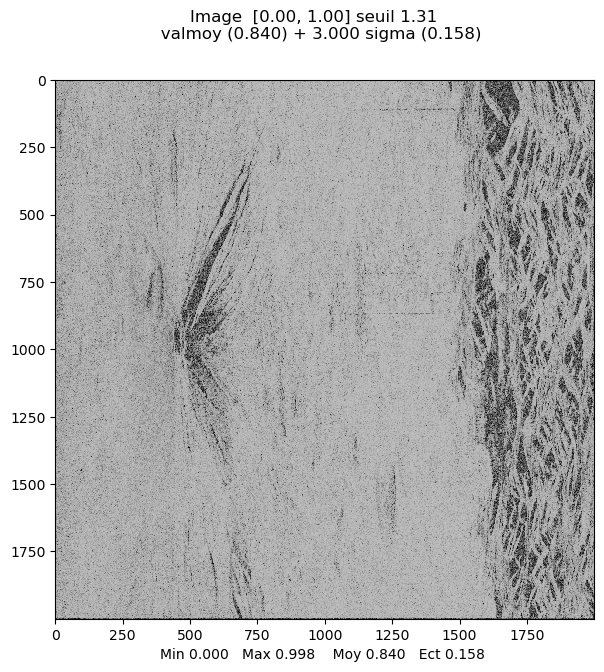

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


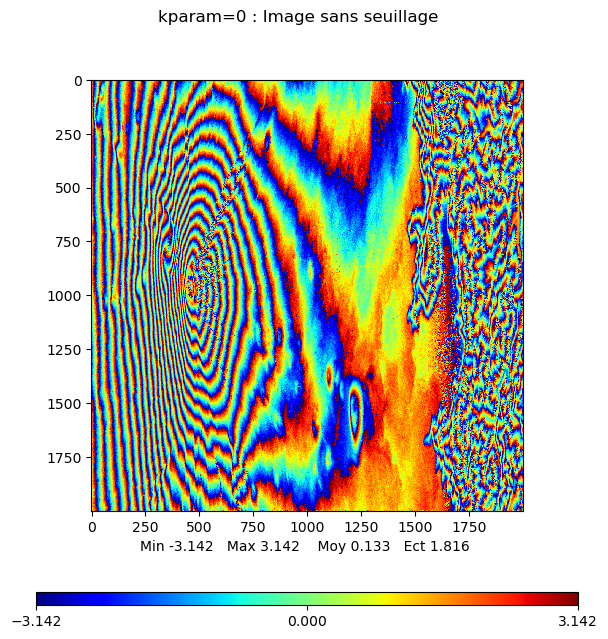

array([[ 1.23314747,  1.22855797,  1.68328064, ..., -2.51181088,
        -2.31730223, -2.22753025],
       [ 1.26292809,  1.23244871,  1.54093385, ..., -2.47539981,
        -2.14401643, -2.01403675],
       [ 1.49460558,  1.41933516,  1.48372905, ..., -2.65736988,
        -2.38249991, -2.1392455 ],
       ...,
       [ 1.14244267,  1.08019158,  1.17332852, ...,  0.07607477,
         0.660764  ,  1.85183625],
       [ 2.48189053,  2.30360884,  1.48050461, ..., -0.06247282,
        -0.99837183, -2.94581892],
       [ 3.06570632,  2.91715034,  2.12680526, ..., -0.2850958 ,
        -1.25140087, -2.58761162]])

In [47]:
imaslavefine= np.multiply(imaslaveroll,onde)
filtered_interferogram = interferogramme(imamaitre,imaslavefine)
mvalab.visusar(np.abs(filtered_interferogram))
mvalab.visuinterfero(np.angle(filtered_interferogram),0)

### Question 3.7
Can you apply the convolution directly on the interferometric phase image ? 
What would happen in that case?

### Answer 3.7
No, we can't apply the convolution directly on the interferometric phase image. The phase is not a real image, it is a complex image. We can't apply a convolution on a complex image. 